# Imports

In [1]:
import os
import pickle
import numpy as np
from glob import glob
from datetime import datetime
import matplotlib.pyplot as plt

import sys
sys.path.append("../")

from utils import show_detections

# Paths to the data

In [2]:
data_paths = ["./Data/test_data_1",
              "./Data/test_data_2",
              "./Data/test_data_3"]

# Ground Truth labels

In [3]:
labels_paths = ["./Data/test_data_1/labels",
                "./Data/test_data_2/labels",
                "./Data/test_data_3/labels"]

# New Model

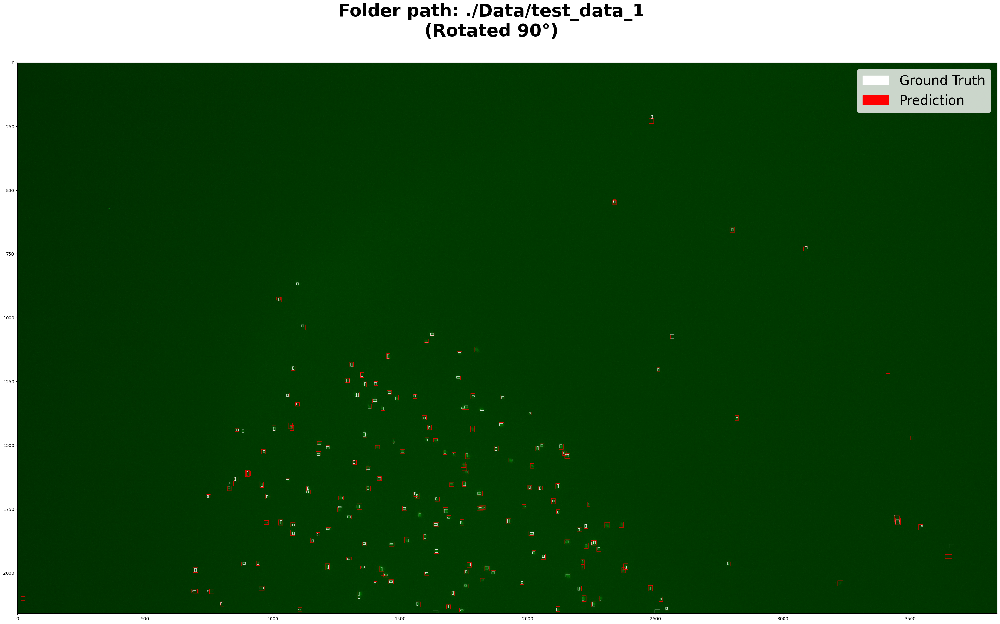

Counting accuracy:  100.00%

	Actual bacteria count:    189
	Predicted bacteria count: 189

Detection time --- 35.51 sec.



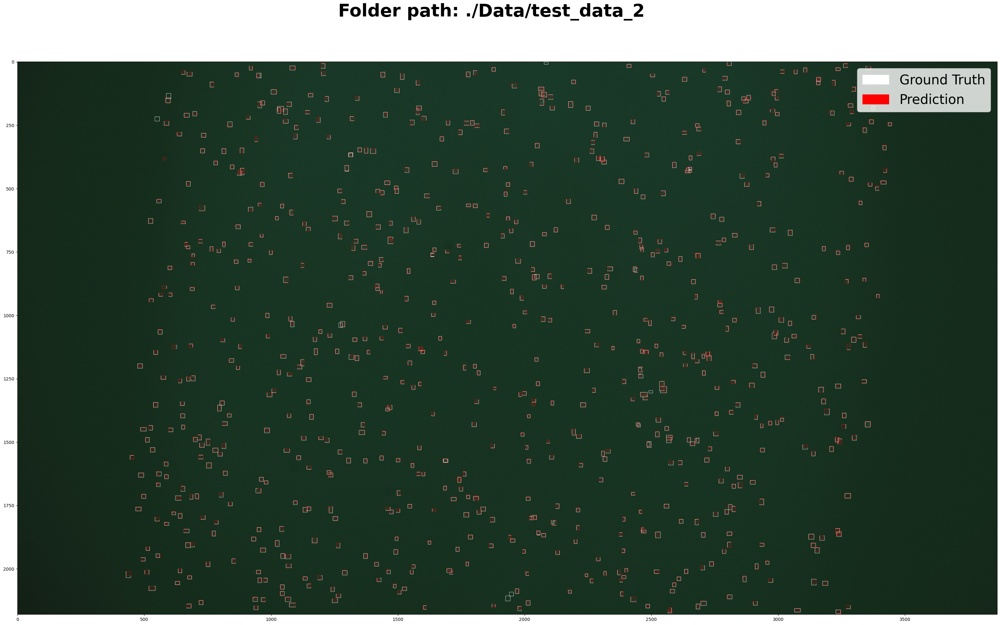

Counting accuracy:  99.08%

	Actual bacteria count:    758
	Predicted bacteria count: 751

Detection time --- 32.53 sec.



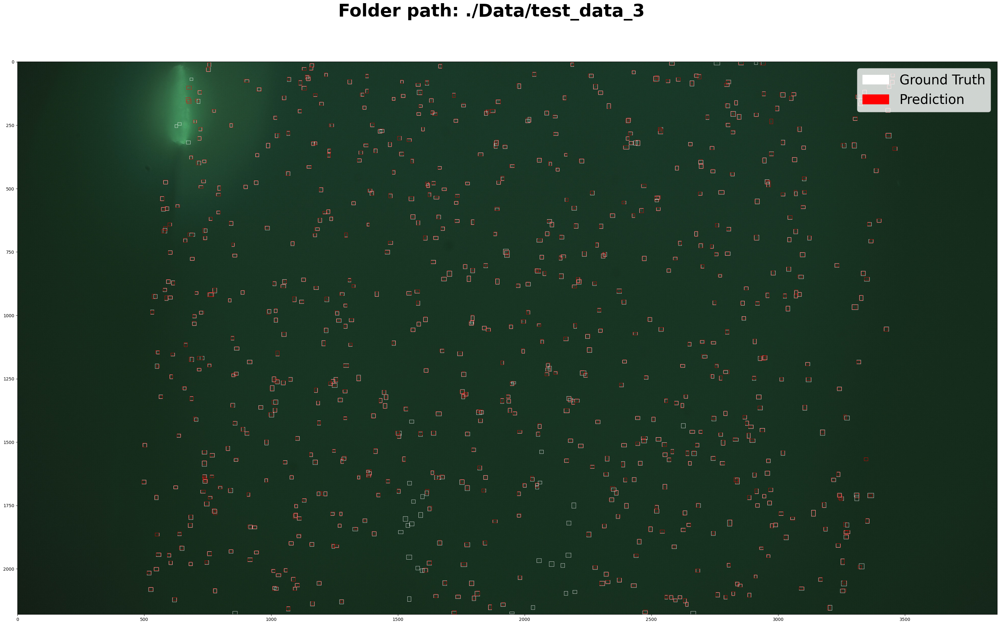

Counting accuracy:  96.84%

	Actual bacteria count:    792
	Predicted bacteria count: 767

Detection time --- 31.41 sec.



In [4]:
# Prediction paths
pred_paths = ["../results/new/test_data_1_2023_02_08:16_47_18/results.pkl",
              "../results/new/test_data_2_2023_02_08:16_46_41/results.pkl",
              "../results/new/test_data_3_2023_02_08:16_46_07/results.pkl"]

new_metrics, new_times = show_detections(data_paths, pred_paths, model="new")

# Old Model

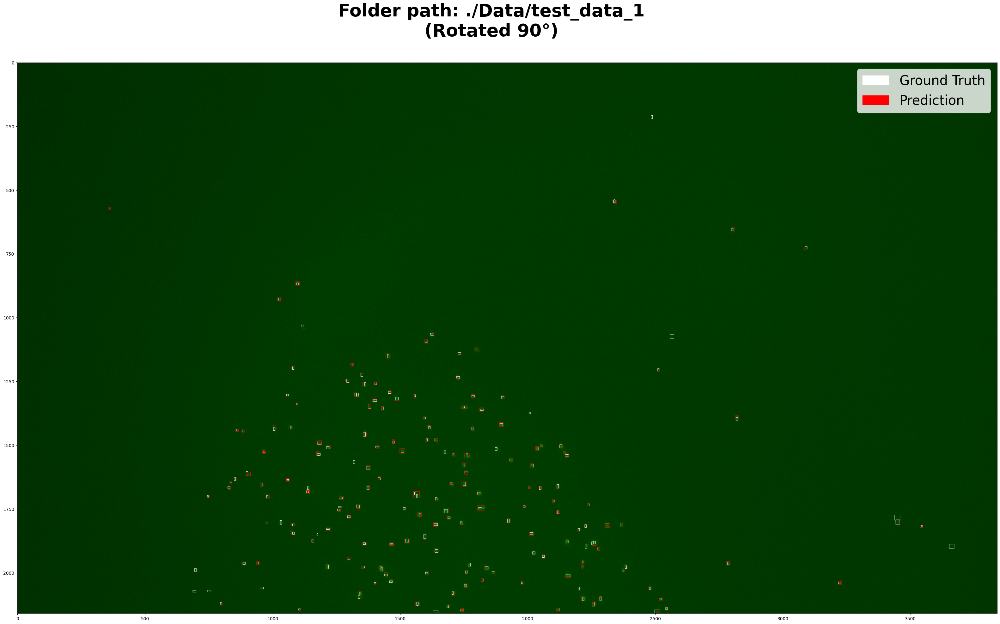

Counting accuracy:  89.42%

	Actual bacteria count:    189
	Predicted bacteria count: 169

Detection time --- 289.20 sec.



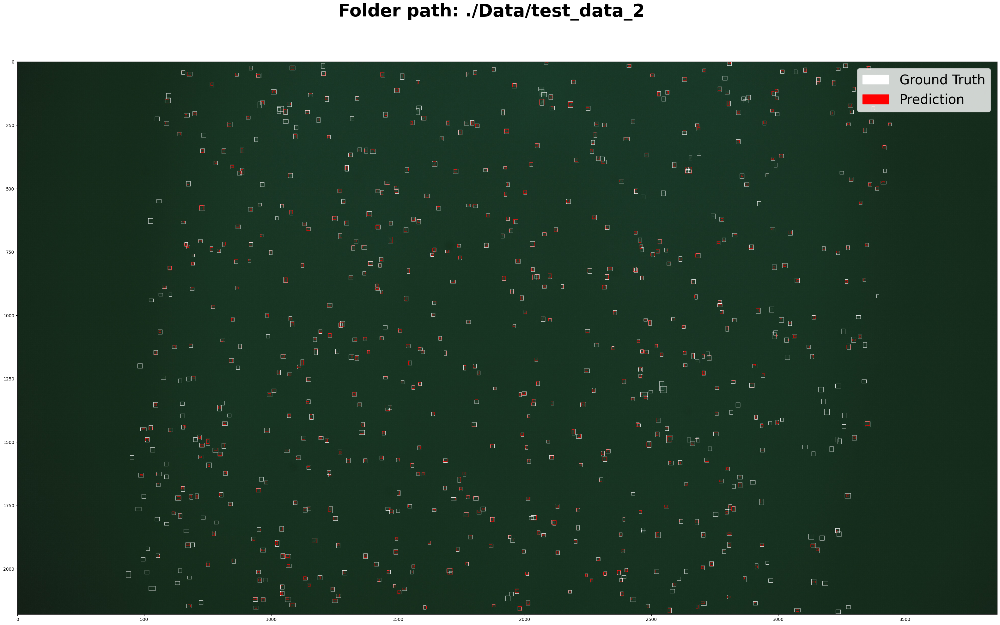

Counting accuracy:  80.61%

	Actual bacteria count:    758
	Predicted bacteria count: 611

Detection time --- 293.50 sec.



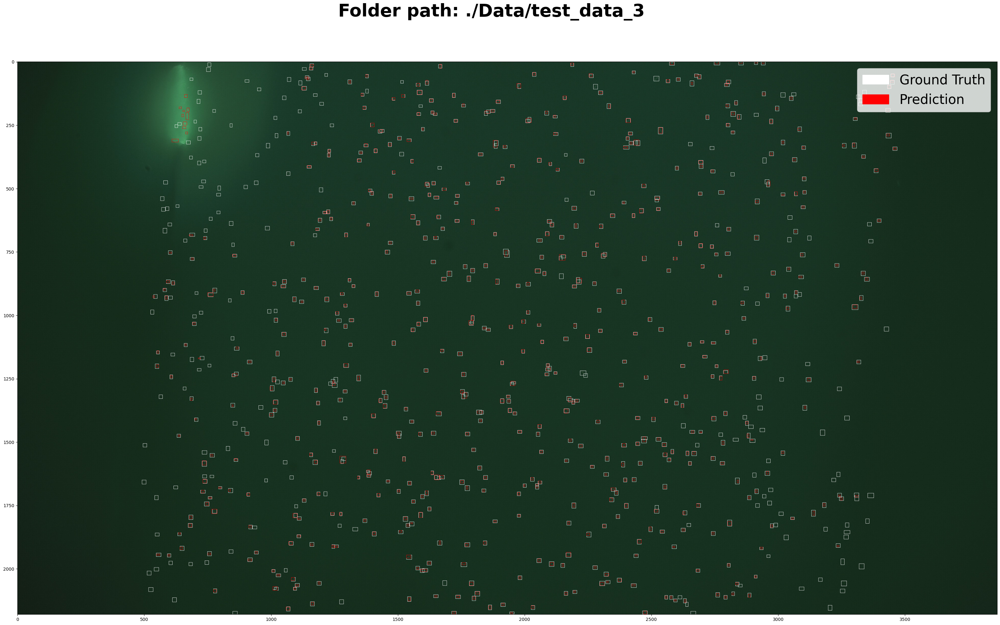

Counting accuracy:  74.12%

	Actual bacteria count:    792
	Predicted bacteria count: 587

Detection time --- 200.80 sec.



In [5]:
pred_paths = ["./Old_Model/bboxes_test_data_1.npy",
              "./Old_Model/bboxes_test_data_2.npy",
              "./Old_Model/bboxes_test_data_3.npy"]

old_metrics, old_times = show_detections(data_paths, pred_paths, model="old")

# Graphs

In [6]:
old_fnames = []

def get_line(x,y):
    from scipy import stats

    slope, intercept, r, p, std_err = stats.linregress(x, y)

    def func(x):
        return slope * x + intercept

    model = list(map(func, x))
    return (x, model)

def get_old_model_stats():
    old_counts = []
    old_times = []
    with open('./Old_Model/Timings/times.txt','r') as f:
        for i in f.readlines():
            data = i.replace("\n","").split(": ")
            old_times.append(float(data[1]))
            old_fnames.append(data[0].split('/')[-1])

            fname = f"./Old_Model/Timings/bboxes_{old_fnames[-1]}.npy"
            old_counts.append(np.load(fname).shape[0])

    old_counts = np.array(old_counts)
    old_times = np.array(old_times)

    old_mask = np.argsort(old_counts)

    return old_counts[old_mask], old_times[old_mask]   

def get_new_model_stats():
    global old_fnames
    
    new_counts = []
    new_times = []
    for i in old_fnames:
        fname = glob(f"../results/Timings/{i}*/results.pkl")[0]
        with open(fname, "rb") as f:
            box, time = pickle.load(f)
        new_counts.append(box.shape[0])
        new_times.append(time["total_time"])

    new_counts = np.array(new_counts)
    new_times = np.array(new_times)

    new_mask = np.argsort(new_counts)
    
    return new_counts[new_mask], new_times[new_mask]

In [7]:
old_counts, old_times = get_old_model_stats()
new_counts, new_times = get_new_model_stats()

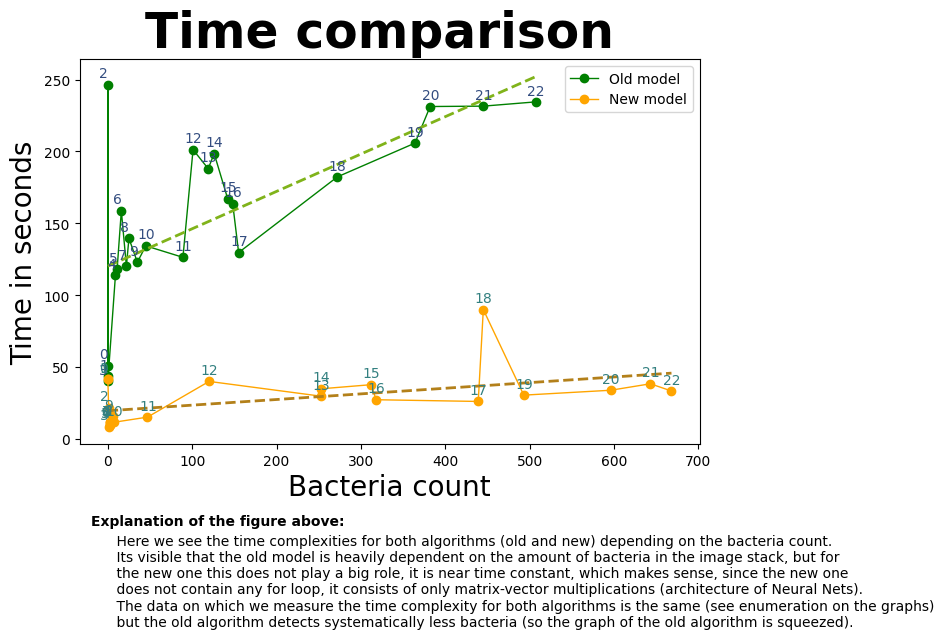

In [8]:
plt.figure(figsize=(8,5))

plt.plot(old_counts, old_times,  marker='o', ms=6, color='green', label='Old model', linewidth=1)
plt.plot(new_counts, new_times,  marker='o', ms=6, color='orange', label='New model', linewidth=1)
plt.plot(*get_line(old_counts, old_times), '--', color=(0.5,0.7,0.1),  linewidth=2)
plt.plot(*get_line(new_counts, new_times),  '--', color=(0.7,0.5,0.1),  linewidth=2)



for i in range(old_counts.shape[0]):
    plt.annotate(i, (old_counts[i]-10, old_times[i]+5), color=(0.2,0.3,0.5))
for i in range(new_counts.shape[0]):
    plt.annotate(i, (new_counts[i]-10, new_times[i]+5), color=(0.2,0.5,0.5))



plt.suptitle('Time comparison', fontweight='bold', fontsize=35)
plt.ylabel('Time in seconds', fontsize=20)
plt.xlabel('Bacteria count', fontsize=20) 

plt.legend(loc="upper right", prop={'size': 10})
plt.text(-20,-60,"Explanation of the figure above:", fontweight="bold")
plt.text(-10,-130,"""
    Here we see the time complexities for both algorithms (old and new) depending on the bacteria count.
    Its visible that the old model is heavily dependent on the amount of bacteria in the image stack, but for 
    the new one this does not play a big role, it is near time constant, which makes sense, since the new one 
    does not contain any for loop, it consists of only matrix-vector multiplications (architecture of Neural Nets).
    The data on which we measure the time complexity for both algorithms is the same (see enumeration on the graphs)
    but the old algorithm detects systematically less bacteria (so the graph of the old algorithm is squeezed).""")
plt.show()

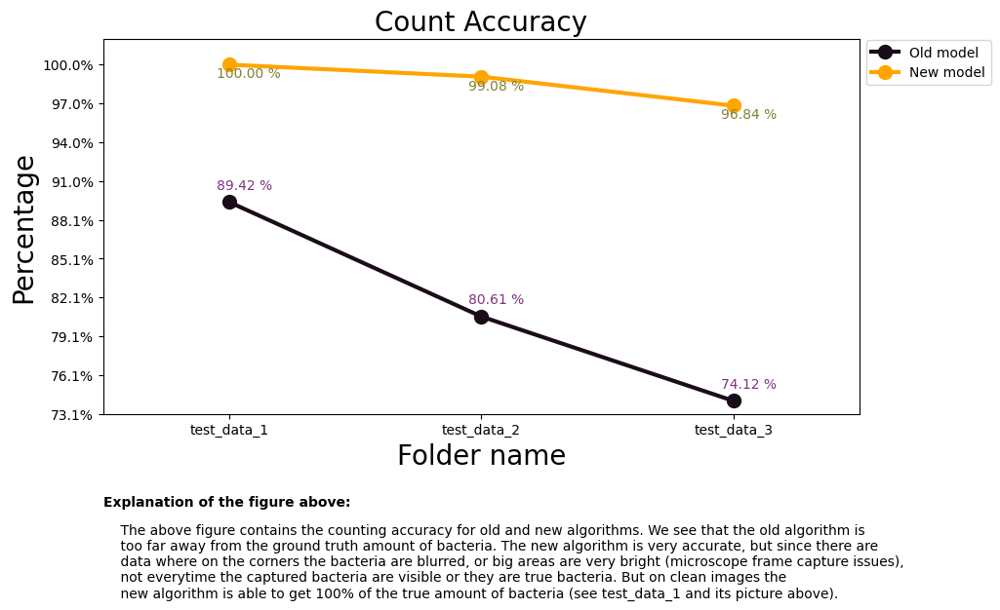

In [9]:
folder_names = [f"test_data_{i}" for i in range(1, 4)]
f0, acc = plt.subplots(1, 1, figsize=(10,5))
keys = list(new_metrics.keys())

for i, ax in enumerate((acc,)):
    ax.plot(old_metrics[keys[i]], marker='o', ms=10, color=(0.1,0.05,0.1), label='Old model', linewidth=3)
    ax.plot(new_metrics[keys[i]], marker='o', ms=10, color='orange', label='New model', linewidth=3)

    ax.set_title(keys[i],fontsize=20)
    ax.set_xticks([0,1,2], folder_names)
    ymin = min(min(old_metrics[keys[i]]),min(new_metrics[keys[i]]))-1
    ymax = max(max(old_metrics[keys[i]]),max(new_metrics[keys[i]]))+2
    ax.axis([-0.5, 2.5, ymin, ymax])
    ax.set_yticks(np.linspace(ymin,np.clip(ymax,0,100),10), labels=[f"{i:.1f}%" for i in np.linspace(ymin,np.clip(ymax,0,100),10)])
    
    for j, txt in enumerate(old_metrics[keys[i]]):
        ax.annotate(f"{txt:.2f} %", (j-0.05, txt+1), color=(0.5,0.2,0.5))
    for j, txt in enumerate(new_metrics[keys[i]]):
        ax.annotate(f"{txt:.2f} %", (j-0.05, txt-1), color=(0.5,0.5,0.2))
        
acc.legend(loc="center left", bbox_to_anchor=(1,0.936), prop={'size':10});

plt.ylabel('Percentage', fontsize=20)
plt.xlabel('Folder name', fontsize=20) 
plt.text(-0.5,66,"Explanation of the figure above:", fontweight="bold")
plt.text(-0.5,59,"""
    The above figure contains the counting accuracy for old and new algorithms. We see that the old algorithm is 
    too far away from the ground truth amount of bacteria. The new algorithm is very accurate, but since there are
    data where on the corners the bacteria are blurred, or big areas are very bright (microscope frame capture issues), 
    not everytime the captured bacteria are visible or they are true bacteria. But on clean images the
    new algorithm is able to get 100% of the true amount of bacteria (see test_data_1 and its picture above).""")
plt.show()